In [1]:
import sys
print(sys.executable)


e:\VS Code Projects\ML Notebooks\ML\venv\Scripts\python.exe


In [100]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
%matplotlib inline


In [41]:
training_set = pd.read_csv('Salary.csv')


X = training_set.iloc[:, 0].to_numpy()
y = training_set.iloc[:, -1].to_numpy()
y = y / 1000
print(y)


[ 39.343  46.205  37.731  43.525  39.891  56.642  60.15   54.445  64.445
  57.189  63.218  55.794  56.957  57.081  61.111  67.938  66.029  83.088
  81.363  93.94   91.738  98.273 101.302 113.812 109.431 105.582 116.969
 112.635 122.391 121.872 127.345 126.756 128.765 135.675 139.465]


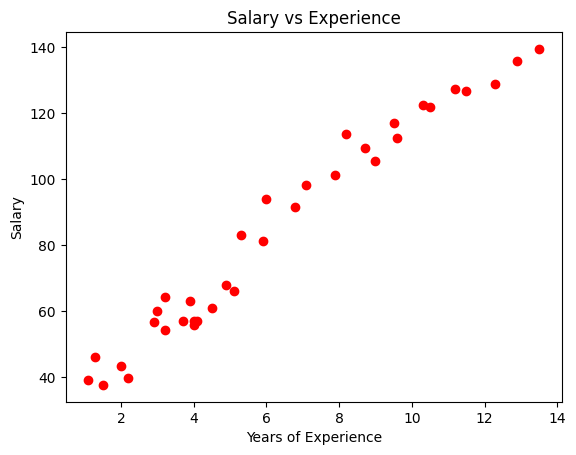

In [42]:
plt.scatter(X, y, color='red')
plt.xlabel('Years of Experience')
plt.ylabel('Salary')
plt.title('Salary vs Experience')
plt.show()

In [80]:
class LinearRegression:
    def __init__(self, alpha, w = 0 ,b = 0):
        self.alpha = alpha
        self.w = w
        self.b = b
        
        
    def cost_function(self, x , y):
        m = y.size
        cost = 0
        for i in range(m):
            cost += (self.w * x[i] + self.b - y[i]) ** 2
        cost /= 2 * m
        return cost
    
    
    def gradient_function(self, x, y):
        m = y.size
        cost_derivative_w,cost_derivative_b = 0,0
        for i in range(m):
            cost_derivative_w += x[i] * (self.w * x[i] + self.b - y[i])
            cost_derivative_b += (self.w * x[i] + self.b - y[i])
        cost_derivative_w /= m
        cost_derivative_b /= m
        return cost_derivative_w,cost_derivative_b
    
    
    def gradient_descent(self, x, y, max_iterations = 200):
        cost_iterations, w_iterations, b_iterations = [],[],[]
        for i in range(max_iterations):
            dc_dw,dc_db = self.gradient_function(x,y)
            self.w -= self.alpha * dc_dw
            self.b -= self.alpha * dc_db
            print(f"Iteration {i}: w = {self.w}, b = {self.b}, cost = {self.cost_function(x,y)}")
            cost_iterations.append(self.cost_function(x,y))
            w_iterations.append(self.w)
            b_iterations.append(self.b)
        return cost_iterations, w_iterations, b_iterations
    
    
    def gradient_descent_adaptive(self, x, y, max_iterations = 1000):
        cost_iterations, w_iterations, b_iterations = [],[],[]
        last_dc_dw,last_dc_db = self.gradient_function(x,y)
        for i in range(1,max_iterations):
            dc_dw,dc_db = self.gradient_function(x,y)
            if(last_dc_dw * dc_dw < 0 or last_dc_db * dc_db < 0):
                self.alpha *= 0.5
            else:
                self.alpha *= 1.05
            self.w -= self.alpha * dc_dw
            self.b -= self.alpha * dc_db
            print(f"Iteration {i}: w = {self.w}, b = {self.b}, alpha = {self.alpha}, dc_dw: {last_dc_dw * dc_dw < 0}, dc_db: {last_dc_db * dc_db < 0} cost = {self.cost_function(x,y)}")
            last_dc_dw,last_dc_db = dc_dw,dc_db
            cost_iterations.append(self.cost_function(x,y))
            w_iterations.append(self.w)
            b_iterations.append(self.b)
        return cost_iterations, w_iterations, b_iterations
            
            
            
            
            
            
        
        
        

In [83]:
linear_regression_model = LinearRegression(0.00001,0,0)
cost_iterations1, w_iterations1, b_iterations1 = linear_regression_model.gradient_descent(X,y, max_iterations= 100000)
cost_iterations2, w_iterations2, b_iterations2 = linear_regression_model.gradient_descent_adaptive(X,y, max_iterations= 100000)


Iteration 0: w = 0.006406489571428571, b = 0.0008394559999999999, cost = 4021.699300507433
Iteration 1: w = 0.012809561606678392, b = 0.0016784994474693224, cost = 4017.530078819718
Iteration 2: w = 0.01920921792660705, b = 0.0025171305621312034, cost = 4013.365298172171
Iteration 3: w = 0.025605460351101984, b = 0.003355349563591812, cost = 4009.204953833724
Iteration 4: w = 0.03199829069908101, b = 0.004193156671340312, cost = 4005.0490410783486
Iteration 5: w = 0.038387710788492825, b = 0.0050305521047489254, cost = 4000.8975551850494
Iteration 6: w = 0.04477372243631754, b = 0.0058675360830729925, cost = 3996.7504914378624
Iteration 7: w = 0.051156327458567186, b = 0.006704108825451036, cost = 3992.6078451258463
Iteration 8: w = 0.057535527670286225, b = 0.0075402705509048235, cost = 3988.4696115430793
Iteration 9: w = 0.06391132488555208, b = 0.00837602147833943, cost = 3984.335785988651
Iteration 10: w = 0.07028372091747564, b = 0.009211361826543295, cost = 3980.206363766662
Iter

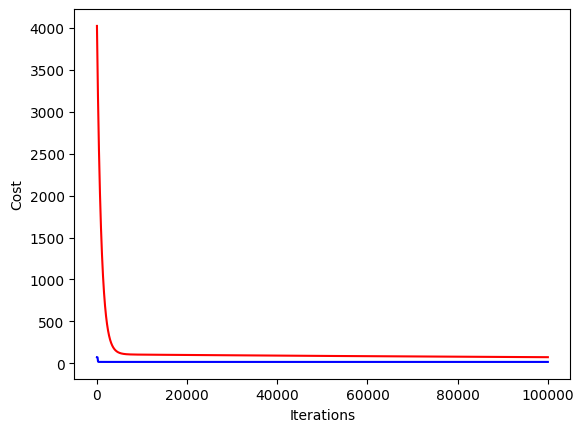

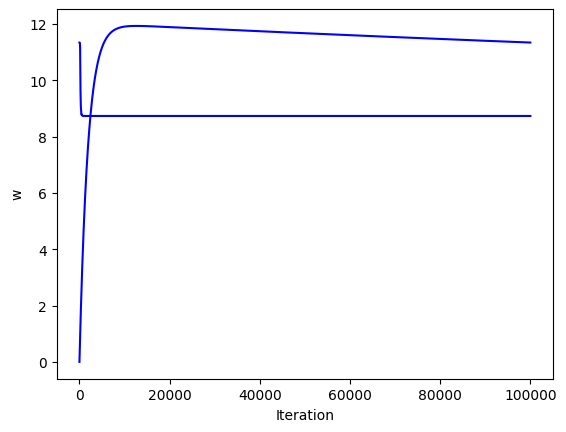

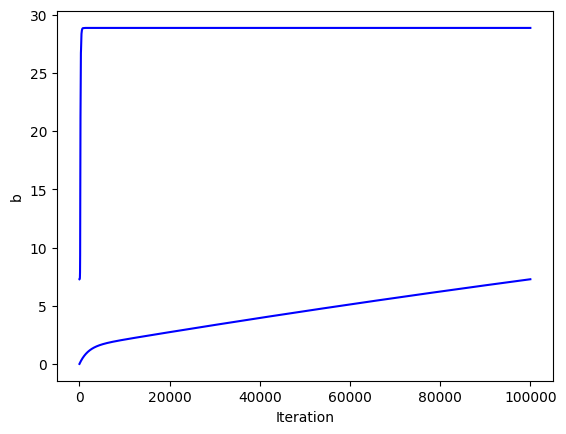

In [ ]:
plt.plot([i for i in range(len(cost_iterations1))], cost_iterations1 , color='red')
plt.plot([i for i in range(len(cost_iterations2))], cost_iterations2 , color='blue')
plt.xlabel('Iterations')
plt.ylabel('Cost')
plt.show()
plt.plot([i for i in range(len(w_iterations1))], w_iterations1, color = 'blue')
plt.plot([i for i in range(len(w_iterations2))], w_iterations2, color = 'blue')
plt.xlabel('Iteration')
plt.ylabel('w')
plt.show()
plt.plot([i for i in range(len(b_iterations1))], b_iterations1, color = 'blue')
plt.plot([i for i in range(len(b_iterations2))], b_iterations2, color = 'blue')
plt.xlabel('Iteration')
plt.ylabel('b')
plt.show()

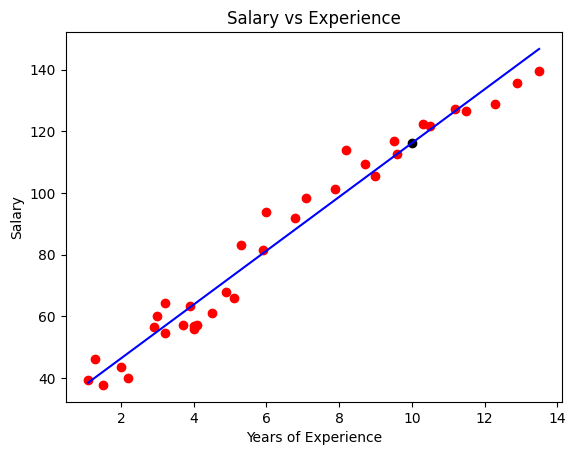

In [91]:
estimated_y = linear_regression_model.w * X + linear_regression_model.b
plt.scatter(X, y, color='red')
plt.plot(X, estimated_y, color = 'blue', label = 'Predicted')
plt.scatter([10], [linear_regression_model.w * 10 + linear_regression_model.b], color = 'black')
plt.xlabel('Years of Experience')
plt.ylabel('Salary')
plt.title('Salary vs Experience')
plt.show()

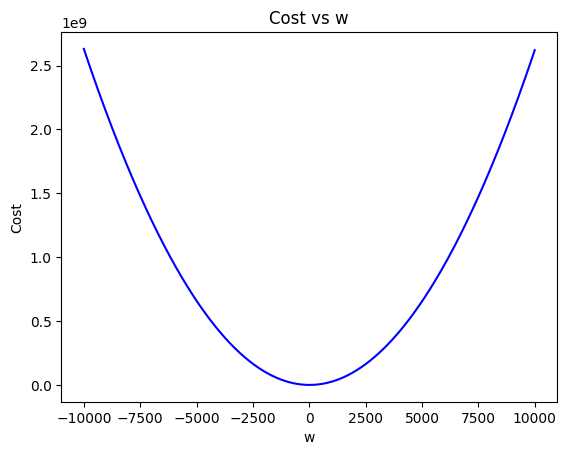

In [107]:
def compute_cost(x, y, w, b): 
    # number of training examples
    m = x.shape[0] 
    
    cost_sum = 0 
    for i in range(m): 
        f_wb = w * x[i] + b   
        cost = (f_wb - y[i]) ** 2  
        cost_sum = cost_sum + cost  
    total_cost = (1 / (2 * m)) * cost_sum  

    return total_cost

cost_per_w = np.array([compute_cost(X,y, i, 28.8) for i in range(-10000,10000)])
plt.plot(np.linspace(-10000,10000,20000), cost_per_w, color = 'blue', label = 'Predicted')
plt.xlabel('w')
plt.ylabel('Cost')
plt.title('Cost vs w')
plt.show()
